<a href="https://colab.research.google.com/github/siammah/Bank-Sentiment-Analysis-Colab/blob/main/team3_colabsetup.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This is Darren here, a hardworking high schooler


In [ ]:

print("Hello World from Darren")

print('hello from Siam') #Nice to be working with you all

print("Hello from Jinwoo") #Excited to work this summer

print("Hello from Elham") #I'm interested to work with AI models with you guys this summer

Hello World from Darren
hello from Siam
Hello from Jinwoo
Hello from Elham


**Importing the libraries and loading the data**

In [ ]:
# some basic libraries
import pandas as pd
import gdown
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")
import io

# some libraries useful for text pre-processing and text data exploration
import re, string
!pip install pyLDAvis

# Import necessary libraries
import gensim
import pyLDAvis
import pyLDAvis.gensim_models
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
nltk.download('stopwords')
nltk.download('punkt')
from bs4 import BeautifulSoup
from wordcloud import WordCloud

# some libraries for for model-building and evaluation
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, f1_score, accuracy_score, confusion_matrix
from sklearn.metrics import roc_curve, auc, roc_auc_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay


from sklearn.svm import LinearSVC
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.metrics import accuracy_score, classification_report
import numpy as np

# some libraries for feature extraction from texts
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer #bag of words
from gensim.models import Word2Vec #word embedding


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:
url = 'https://drive.google.com/file/d/1r5xDdeOsuwUDZy_1GVNf_hS8vxQ7LtEV/view?usp=share_link'

# Extract file ID from the URL
file_id = url.split('/')[-2]

# Construct the download URL
dwn_url = f'https://drive.google.com/uc?id={file_id}'

# Download the file
output = 'complaints.csv'
gdown.download(dwn_url, output, quiet=False)

# Read the downloaded CSV file into a DataFrame
data = pd.read_csv(output)

data.head()


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
Downloading...
From (original): https://drive.google.com/uc?id=1r5xDdeOsuwUDZy_1GVNf_hS8vxQ7LtEV
From (redirected): https://drive.google.com/uc?id=1r5xDdeOsuwUDZy_1GVNf_hS8vxQ7LtEV&confirm=t&uuid=8d47548b-7fde-44aa-8006-33a20dd2b5f4
To: /content/complaints.csv
100%|██████████| 2.17G/2.17G [00:33<00:00, 64.6MB/s]


,Date received,Product,Sub-product,Issue,Sub-issue,Consumer complaint narrative,Company public response,Company,State,ZIP code,Tags,Consumer consent provided?,Submitted via,Date sent to company,Company response to consumer,Timely response?,Consumer disputed?,Complaint ID
0,2022-12-25,Credit card or prepaid card,Gift card,Unexpected or other fees,NaN,NaN,NaN,Incomm Holdings Inc.,NY,11576.0,NaN,NaN,Web,2022-12-25,Untimely response,No,NaN,6358716
1,2022-10-17,Credit card or prepaid card,Store credit card,Closing your account,Can't close your account,NaN,NaN,"Bread Financial Holdings, Inc.",PA,19610.0,NaN,NaN,Web,2023-01-03,Closed with explanation,Yes,NaN,6096325
2,2023-01-10,"Credit reporting, credit repair services, or o...",Credit reporting,Incorrect information on your report,Information belongs to someone else,NaN,NaN,"EQUIFAX, INC.",PA,19127.0,NaN,NaN,Web,2023-01-10,In progress,Yes,NaN,6413829
3,2022-12-31,"Credit reporting, credit repair services, or o...",Credit reporting,Improper use of your report,Credit inquiries on your report that you don't...,NaN,Company has responded to the consumer and the ...,Experian Information Solutions Inc.,MO,63033.0,NaN,Consent not provided,Web,2022-12-31,Closed with non-monetary relief,Yes,NaN,6382980
4,2022-12-29,Credit card or prepaid card,General-purpose prepaid card,Unexpected or other fees,NaN,NaN,NaN,AMERICAN EXPRESS COMPANY,CA,90746.0,NaN,NaN,Web,2022-12-29,Closed with explanation,Yes,NaN,6375967


In [ ]:
data['Company'].value_counts()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,count
Company,
"EQUIFAX, INC.",562111
"TRANSUNION INTERMEDIATE HOLDINGS, INC.",467190
Experian Information Solutions Inc.,436041
"BANK OF AMERICA, NATIONAL ASSOCIATION",121461
WELLS FARGO & COMPANY,103010
JPMORGAN CHASE & CO.,97600
"CITIBANK, N.A.",80527
CAPITAL ONE FINANCIAL CORPORATION,75514
SYNCHRONY FINANCIAL,40968


In [ ]:
citigroup_data = data[data['Company'] == 'CITIBANK, N.A.']
citigroup_data.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,Date received,Product,Sub-product,Issue,Sub-issue,Consumer complaint narrative,Company public response,Company,State,ZIP code,Tags,Consumer consent provided?,Submitted via,Date sent to company,Company response to consumer,Timely response?,Consumer disputed?,Complaint ID
55,2022-12-30,"Money transfer, virtual currency, or money ser...",Domestic (US) money transfer,Other transaction problem,NaN,A Wire transfer of {$23000.00} was initiated o...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",CA,91730.0,NaN,Consent provided,Web,2022-12-30,Closed with explanation,Yes,NaN,6378719
75,2022-12-26,Checking or savings account,Checking account,Closing an account,Can't close your account,My father passed away on XX/XX/2022. I informe...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",WA,98102.0,NaN,Consent provided,Web,2022-12-26,Closed with explanation,Yes,NaN,6361109
80,2022-12-25,Credit card or prepaid card,General-purpose credit card or charge card,Problem with a purchase shown on your statement,Credit card company isn't resolving a dispute ...,"Back in XXXX of 2021, I bought a XXXXXXXX XXXX...",Company has responded to the consumer and the ...,"CITIBANK, N.A.",SC,29072.0,NaN,Consent provided,Web,2022-12-25,Closed with monetary relief,Yes,NaN,6359652
154,2022-12-28,Credit card or prepaid card,Store credit card,Problem with a purchase shown on your statement,Credit card company isn't resolving a dispute ...,I am a platinum card holder with Macys. I gene...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",DC,20012.0,NaN,Consent provided,Web,2022-12-28,Closed with explanation,Yes,NaN,6368493
234,2022-12-07,"Credit reporting, credit repair services, or o...",Credit reporting,Improper use of your report,Credit inquiries on your report that you don't...,I disputed the unknown inquires and the compan...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",MD,20743.0,NaN,Consent provided,Web,2022-12-30,Closed with explanation,Yes,NaN,6286123


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Timely response?
Yes    80158
No       369
Name: count, dtype: int64


<Axes: xlabel='Timely response?', ylabel='count'>

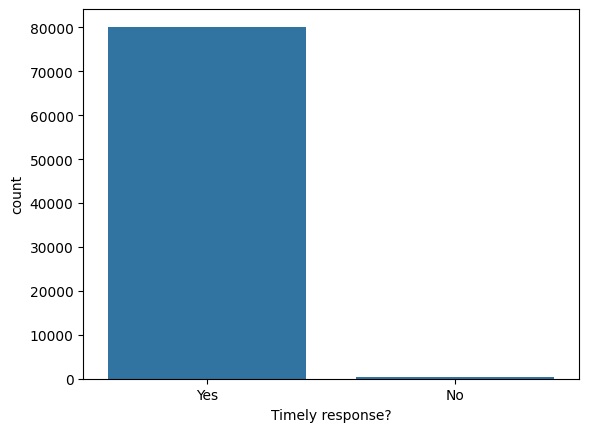

In [ ]:
x= citigroup_data['Timely response?'].value_counts()
print(x)
sns.barplot(x=x.index, y=x)


Consumer disputed?
No     28071
Yes     6697
Name: count, dtype: int64


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


<Axes: xlabel='Consumer disputed?', ylabel='count'>

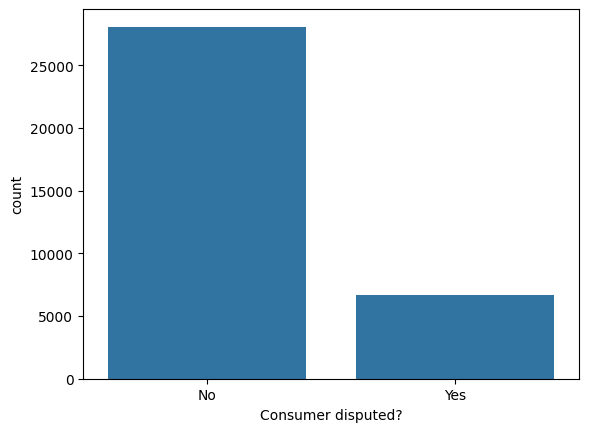

In [ ]:
x=citigroup_data['Consumer disputed?'].value_counts()
print(x)
sns.barplot(x=x.index, y=x)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Product
Credit card or prepaid card                                                     22092
Credit card                                                                     16817
Mortgage                                                                        10249
Checking or savings account                                                      8967
Credit reporting, credit repair services, or other personal consumer reports     7868
Debt collection                                                                  6859
Bank account or service                                                          4450
Money transfer, virtual currency, or money service                                844
Consumer Loan                                                                     765
Student loan                                                                      737
Credit reporting                                                                  267
Payday loan, title loan, or personal loan     

<Axes: title={'center': 'Count of Different Products'}, xlabel='Product', ylabel='count'>

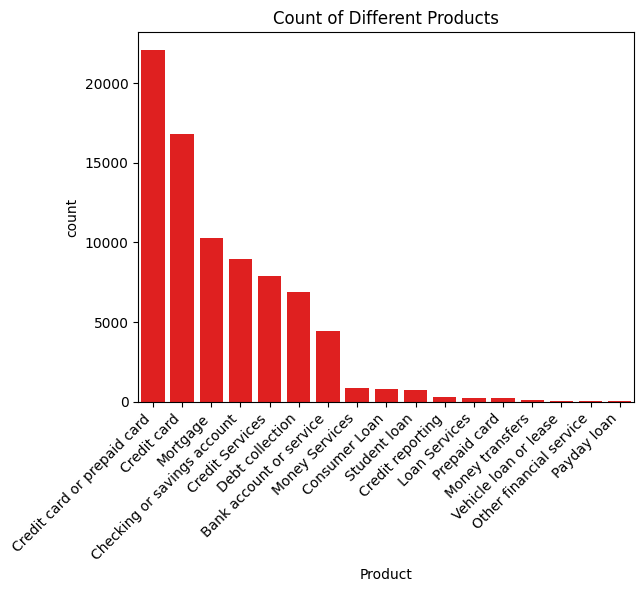

In [ ]:
x=citigroup_data['Product'].value_counts()
print(x)
plt.xticks(rotation=45, ha='right')
plt.title("Count of Different Products", color='black')
new_labels = {
    'Credit reporting, credit repair services, or other personal consumer reports': 'Credit Services',
    'Money transfer, virtual currency, or money service': 'Money Services',
    'Payday loan, title loan, or personal loan': 'Loan Services'
}
ax = sns.barplot(x=x.index, y=x)
current_labels = [item.get_text() for item in ax.get_xticklabels()]
updated_labels = [new_labels.get(label, label) for label in current_labels]
ax.set_xticklabels(updated_labels)
sns.barplot(x=x.index, y=x, color='red')

Consumer consent provided?
Consent provided        29628
Consent not provided    18006
Other                     999
Consent withdrawn         188
Name: count, dtype: int64


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


<Axes: xlabel='Consumer consent provided?', ylabel='count'>

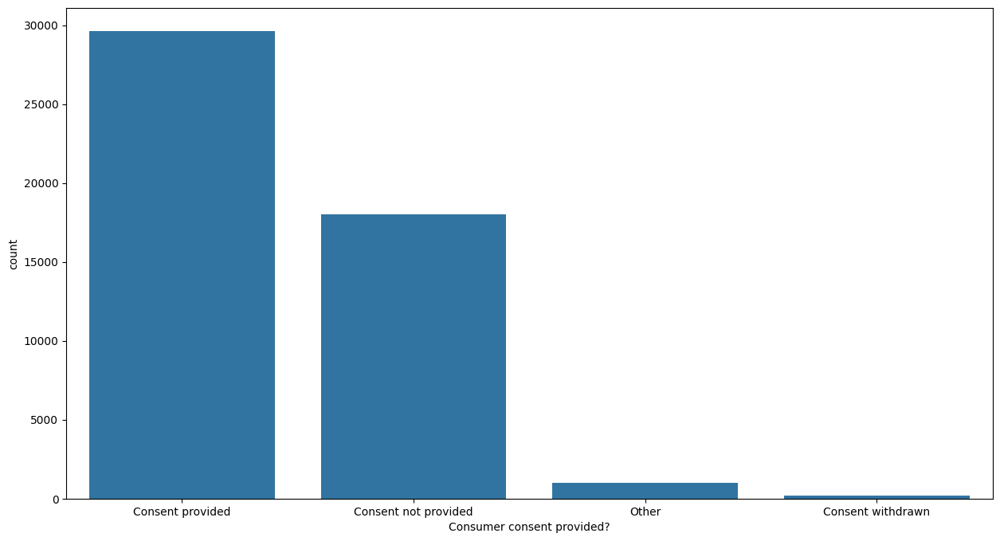

In [ ]:
x=citigroup_data['Consumer consent provided?'].value_counts()
print(x)
plt.figure(figsize=(15, 8))
sns.barplot(x=x.index, y=x)

In [ ]:
x = citigroup_data['Date sent to company'].value_counts()
print(x)

Date sent to company
2012-06-21    96
2021-12-03    78
2020-06-25    71
2016-06-30    61
2018-04-28    61
              ..
2013-05-05     1
2014-09-07     1
2013-06-02     1
2013-03-30     1
2015-06-21     1
Name: count, Length: 3919, dtype: int64


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


**Pre text processing**

Stemming

In [ ]:
def text_stemming(text):
    text = str(text)
    stemmer = nltk.porter.PorterStemmer()
    stemmed = ' '.join([stemmer.stem(token) for token in text.split()])
    return stemmed


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
def preProcess(s):
    j = " ".join([re.sub(r"[0-9]*[X]*[X]+[/]*[0-9]*","",x) for x in s.split()])
    return j

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
citigroup_data['Consumer complaint narrative'] = citigroup_data['Consumer complaint narrative'].astype(str)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
citigroup_data['clean_text'] = citigroup_data['Consumer complaint narrative'].apply(lambda x: preProcess(x))
citigroup_data

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,Date received,Product,Sub-product,Issue,Sub-issue,Consumer complaint narrative,Company public response,Company,State,ZIP code,Tags,Consumer consent provided?,Submitted via,Date sent to company,Company response to consumer,Timely response?,Consumer disputed?,Complaint ID,clean_text
55,2022-12-30,"Money transfer, virtual currency, or money ser...",Domestic (US) money transfer,Other transaction problem,NaN,A Wire transfer of {$23000.00} was initiated o...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",CA,91730.0,NaN,Consent provided,Web,2022-12-30,Closed with explanation,Yes,NaN,6378719,A Wire transfer of {$23000.00} was initiated o...
75,2022-12-26,Checking or savings account,Checking account,Closing an account,Can't close your account,My father passed away on XX/XX/2022. I informe...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",WA,98102.0,NaN,Consent provided,Web,2022-12-26,Closed with explanation,Yes,NaN,6361109,My father passed away on . I informed Citi of ...
80,2022-12-25,Credit card or prepaid card,General-purpose credit card or charge card,Problem with a purchase shown on your statement,Credit card company isn't resolving a dispute ...,"Back in XXXX of 2021, I bought a XXXXXXXX XXXX...",Company has responded to the consumer and the ...,"CITIBANK, N.A.",SC,29072.0,NaN,Consent provided,Web,2022-12-25,Closed with monetary relief,Yes,NaN,6359652,"Back in of 2021, I bought a . I had to sen..."
154,2022-12-28,Credit card or prepaid card,Store credit card,Problem with a purchase shown on your statement,Credit card company isn't resolving a dispute ...,I am a platinum card holder with Macys. I gene...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",DC,20012.0,NaN,Consent provided,Web,2022-12-28,Closed with explanation,Yes,NaN,6368493,I am a platinum card holder with Macys. I gene...
234,2022-12-07,"Credit reporting, credit repair services, or o...",Credit reporting,Improper use of your report,Credit inquiries on your report that you don't...,I disputed the unknown inquires and the compan...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",MD,20743.0,NaN,Consent provided,Web,2022-12-30,Closed with explanation,Yes,NaN,6286123,I disputed the unknown inquires and the compan...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3219444,2015-02-06,Mortgage,FHA mortgage,"Loan modification,collection,foreclosure",NaN,nan,NaN,"CITIBANK, N.A.",AL,35813.0,NaN,NaN,Web,2015-02-06,Closed with explanation,Yes,No,1228172,nan
3219460,2013-02-02,Mortgage,Conventional fixed mortgage,"Application, originator, mortgage broker",NaN,nan,NaN,"CITIBANK, N.A.",PA,19086.0,NaN,NaN,Web,2013-02-04,Closed with explanation,Yes,No,289126,nan
3219498,2012-04-02,Mortgage,Conventional adjustable mortgage (ARM),"Loan modification,collection,foreclosure",NaN,nan,NaN,"CITIBANK, N.A.",MD,21076.0,NaN,NaN,Phone,2012-04-04,Untimely response,No,No,43279,nan
3220559,2016-09-29,Bank account or service,Checking account,"Account opening, closing, or management",NaN,Near the end of XXXX 2016 I opened a Citigold ...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",CA,90049.0,NaN,Consent provided,Web,2016-09-29,Closed with non-monetary relief,Yes,No,2138969,Near the end of 2016 I opened a Citigold chec...


In [ ]:
citigroup_data['stemmed_complaints'] = citigroup_data['clean_text'].apply(text_stemming)
citigroup_data

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,Date received,Product,Sub-product,Issue,Sub-issue,Consumer complaint narrative,Company public response,Company,State,ZIP code,Tags,Consumer consent provided?,Submitted via,Date sent to company,Company response to consumer,Timely response?,Consumer disputed?,Complaint ID,clean_text,stemmed_complaints
55,2022-12-30,"Money transfer, virtual currency, or money ser...",Domestic (US) money transfer,Other transaction problem,NaN,A Wire transfer of {$23000.00} was initiated o...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",CA,91730.0,NaN,Consent provided,Web,2022-12-30,Closed with explanation,Yes,NaN,6378719,A Wire transfer of {$23000.00} was initiated o...,a wire transfer of {$23000.00} wa initi onlin ...
75,2022-12-26,Checking or savings account,Checking account,Closing an account,Can't close your account,My father passed away on XX/XX/2022. I informe...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",WA,98102.0,NaN,Consent provided,Web,2022-12-26,Closed with explanation,Yes,NaN,6361109,My father passed away on . I informed Citi of ...,my father pass away on . i inform citi of hi p...
80,2022-12-25,Credit card or prepaid card,General-purpose credit card or charge card,Problem with a purchase shown on your statement,Credit card company isn't resolving a dispute ...,"Back in XXXX of 2021, I bought a XXXXXXXX XXXX...",Company has responded to the consumer and the ...,"CITIBANK, N.A.",SC,29072.0,NaN,Consent provided,Web,2022-12-25,Closed with monetary relief,Yes,NaN,6359652,"Back in of 2021, I bought a . I had to sen...","back in of 2021, i bought a . i had to send it..."
154,2022-12-28,Credit card or prepaid card,Store credit card,Problem with a purchase shown on your statement,Credit card company isn't resolving a dispute ...,I am a platinum card holder with Macys. I gene...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",DC,20012.0,NaN,Consent provided,Web,2022-12-28,Closed with explanation,Yes,NaN,6368493,I am a platinum card holder with Macys. I gene...,i am a platinum card holder with macys. i gene...
234,2022-12-07,"Credit reporting, credit repair services, or o...",Credit reporting,Improper use of your report,Credit inquiries on your report that you don't...,I disputed the unknown inquires and the compan...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",MD,20743.0,NaN,Consent provided,Web,2022-12-30,Closed with explanation,Yes,NaN,6286123,I disputed the unknown inquires and the compan...,i disput the unknown inquir and the compani an...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3219444,2015-02-06,Mortgage,FHA mortgage,"Loan modification,collection,foreclosure",NaN,nan,NaN,"CITIBANK, N.A.",AL,35813.0,NaN,NaN,Web,2015-02-06,Closed with explanation,Yes,No,1228172,nan,nan
3219460,2013-02-02,Mortgage,Conventional fixed mortgage,"Application, originator, mortgage broker",NaN,nan,NaN,"CITIBANK, N.A.",PA,19086.0,NaN,NaN,Web,2013-02-04,Closed with explanation,Yes,No,289126,nan,nan
3219498,2012-04-02,Mortgage,Conventional adjustable mortgage (ARM),"Loan modification,collection,foreclosure",NaN,nan,NaN,"CITIBANK, N.A.",MD,21076.0,NaN,NaN,Phone,2012-04-04,Untimely response,No,No,43279,nan,nan
3220559,2016-09-29,Bank account or service,Checking account,"Account opening, closing, or management",NaN,Near the end of XXXX 2016 I opened a Citigold ...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",CA,90049.0,NaN,Consent provided,Web,2016-09-29,Closed with non-monetary relief,Yes,No,2138969,Near the end of 2016 I opened a Citigold chec...,near the end of 2016 i open a citigold check a...


Stop words

In [ ]:
english_stop_words = nltk.corpus.stopwords.words('english')
additional_stop_words = ['and', 'or', 'an', 'from', 'is', 'are', 'was']
english_stop_words.extend(additional_stop_words)
def remove_stop_words(text):
    for stopword in english_stop_words:
        word = ' ' + stopword + ' '
        start_date = "" + stopword + "/"
        date = '/' + stopword
        text = str(text).replace(start_date, '')
        text = str(text).replace(date, ' ')
        text = str(text).replace(word, ' ')
    return text

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
print(english_stop_words)

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
info = citigroup_data[['Consumer complaint narrative', 'Company public response']]
citigroup_data['lowercase_stopworded_complaints'] = citigroup_data['stemmed_complaints'].apply(remove_stop_words)
citigroup_data


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,Date received,Product,Sub-product,Issue,Sub-issue,Consumer complaint narrative,Company public response,Company,State,ZIP code,...,Consumer consent provided?,Submitted via,Date sent to company,Company response to consumer,Timely response?,Consumer disputed?,Complaint ID,clean_text,stemmed_complaints,lowercase_stopworded_complaints
55,2022-12-30,"Money transfer, virtual currency, or money ser...",Domestic (US) money transfer,Other transaction problem,NaN,A Wire transfer of {$23000.00} was initiated o...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",CA,91730.0,...,Consent provided,Web,2022-12-30,Closed with explanation,Yes,NaN,6378719,A Wire transfer of {$23000.00} was initiated o...,a wire transfer of {$23000.00} wa initi onlin ...,"a wire transfer {$23000.00} wa initi onlin , c..."
75,2022-12-26,Checking or savings account,Checking account,Closing an account,Can't close your account,My father passed away on XX/XX/2022. I informe...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",WA,98102.0,...,Consent provided,Web,2022-12-26,Closed with explanation,Yes,NaN,6361109,My father passed away on . I informed Citi of ...,my father pass away on . i inform citi of hi p...,my father pass away . inform citi hi pass tele...
80,2022-12-25,Credit card or prepaid card,General-purpose credit card or charge card,Problem with a purchase shown on your statement,Credit card company isn't resolving a dispute ...,"Back in XXXX of 2021, I bought a XXXXXXXX XXXX...",Company has responded to the consumer and the ...,"CITIBANK, N.A.",SC,29072.0,...,Consent provided,Web,2022-12-25,Closed with monetary relief,Yes,NaN,6359652,"Back in of 2021, I bought a . I had to sen...","back in of 2021, i bought a . i had to send it...","back 2021, bought . send back twice within 2 m..."
154,2022-12-28,Credit card or prepaid card,Store credit card,Problem with a purchase shown on your statement,Credit card company isn't resolving a dispute ...,I am a platinum card holder with Macys. I gene...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",DC,20012.0,...,Consent provided,Web,2022-12-28,Closed with explanation,Yes,NaN,6368493,I am a platinum card holder with Macys. I gene...,i am a platinum card holder with macys. i gene...,i platinum card holder macys. gener buy produc...
234,2022-12-07,"Credit reporting, credit repair services, or o...",Credit reporting,Improper use of your report,Credit inquiries on your report that you don't...,I disputed the unknown inquires and the compan...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",MD,20743.0,...,Consent provided,Web,2022-12-30,Closed with explanation,Yes,NaN,6286123,I disputed the unknown inquires and the compan...,i disput the unknown inquir and the compani an...,i disput unknown inquir compani credit bureau ...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3219444,2015-02-06,Mortgage,FHA mortgage,"Loan modification,collection,foreclosure",NaN,nan,NaN,"CITIBANK, N.A.",AL,35813.0,...,NaN,Web,2015-02-06,Closed with explanation,Yes,No,1228172,nan,nan,nan
3219460,2013-02-02,Mortgage,Conventional fixed mortgage,"Application, originator, mortgage broker",NaN,nan,NaN,"CITIBANK, N.A.",PA,19086.0,...,NaN,Web,2013-02-04,Closed with explanation,Yes,No,289126,nan,nan,nan
3219498,2012-04-02,Mortgage,Conventional adjustable mortgage (ARM),"Loan modification,collection,foreclosure",NaN,nan,NaN,"CITIBANK, N.A.",MD,21076.0,...,NaN,Phone,2012-04-04,Untimely response,No,No,43279,nan,nan,nan
3220559,2016-09-29,Bank account or service,Checking account,"Account opening, closing, or management",NaN,Near the end of XXXX 2016 I opened a Citigold ...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",CA,90049.0,...,Consent provided,Web,2016-09-29,Closed with non-monetary relief,Yes,No,2138969,Near the end of 2016 I opened a Citigold chec...,near the end of 2016 i open a citigold check a...,near end 2016 open citig

In [ ]:
citigroup_data1 = citigroup_data[~citigroup_data['lowercase_stopworded_complaints'].isin(['nan'])]
citigroup_data1

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,Date received,Product,Sub-product,Issue,Sub-issue,Consumer complaint narrative,Company public response,Company,State,ZIP code,...,Consumer consent provided?,Submitted via,Date sent to company,Company response to consumer,Timely response?,Consumer disputed?,Complaint ID,clean_text,stemmed_complaints,lowercase_stopworded_complaints
55,2022-12-30,"Money transfer, virtual currency, or money ser...",Domestic (US) money transfer,Other transaction problem,NaN,A Wire transfer of {$23000.00} was initiated o...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",CA,91730.0,...,Consent provided,Web,2022-12-30,Closed with explanation,Yes,NaN,6378719,A Wire transfer of {$23000.00} was initiated o...,a wire transfer of {$23000.00} wa initi onlin ...,"a wire transfer {$23000.00} wa initi onlin , c..."
75,2022-12-26,Checking or savings account,Checking account,Closing an account,Can't close your account,My father passed away on XX/XX/2022. I informe...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",WA,98102.0,...,Consent provided,Web,2022-12-26,Closed with explanation,Yes,NaN,6361109,My father passed away on . I informed Citi of ...,my father pass away on . i inform citi of hi p...,my father pass away . inform citi hi pass tele...
80,2022-12-25,Credit card or prepaid card,General-purpose credit card or charge card,Problem with a purchase shown on your statement,Credit card company isn't resolving a dispute ...,"Back in XXXX of 2021, I bought a XXXXXXXX XXXX...",Company has responded to the consumer and the ...,"CITIBANK, N.A.",SC,29072.0,...,Consent provided,Web,2022-12-25,Closed with monetary relief,Yes,NaN,6359652,"Back in of 2021, I bought a . I had to sen...","back in of 2021, i bought a . i had to send it...","back 2021, bought . send back twice within 2 m..."
154,2022-12-28,Credit card or prepaid card,Store credit card,Problem with a purchase shown on your statement,Credit card company isn't resolving a dispute ...,I am a platinum card holder with Macys. I gene...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",DC,20012.0,...,Consent provided,Web,2022-12-28,Closed with explanation,Yes,NaN,6368493,I am a platinum card holder with Macys. I gene...,i am a platinum card holder with macys. i gene...,i platinum card holder macys. gener buy produc...
234,2022-12-07,"Credit reporting, credit repair services, or o...",Credit reporting,Improper use of your report,Credit inquiries on your report that you don't...,I disputed the unknown inquires and the compan...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",MD,20743.0,...,Consent provided,Web,2022-12-30,Closed with explanation,Yes,NaN,6286123,I disputed the unknown inquires and the compan...,i disput the unknown inquir and the compani an...,i disput unknown inquir compani credit bureau ...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3219098,2016-08-11,Debt collection,Credit card,Communication tactics,Called after sent written cease of comm,I sent a letter asking for debt verification a...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",CA,92506.0,...,Consent provided,Web,2016-08-11,Closed with explanation,Yes,No,2058119,I sent a letter asking for debt verification a...,i sent a letter ask for debt verif and to be p...,i sent letter ask debt verif place call list. ...
3219099,2017-03-27,Mortgage,FHA mortgage,"Loan modification,collection,foreclosure",NaN,I spoke with a representative @ CitiMortgage o...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",GA,30326.0,...,Consent provided,Web,2017-03-27,Closed with explanation,Yes,No,2406658,I spoke with a representative @ CitiMortgage o...,i spoke with a repres @ citimortgag on who adv...,i spoke repres @ citimortgag advis addit docum...
3219100,2015-05-09,Credit card,NaN,Late fee,NaN,Purchased XXXX bras and opened a macy 's card....,Company chooses not to provide a public response,"CITIBANK, N.A.",

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

# citigroup_data = citigroup_data[~citigroup_data['lowercase_stopworded_complaints'].isin(['nan'])]
documents = citigroup_data1
vectorizer = TfidfVectorizer()
tfidf_matrix = vectorizer.fit_transform(documents)
feature_names = vectorizer.get_feature_names_out()
tfidf_values = {}

for doc_index, doc in enumerate(documents):
    feature = tfidf_matrix[doc_index, :].nonzero()[1]
    tfidf_doc_values = zip(feature, [tfidf_matrix[doc_index, x] for x in feature])
    tfidf_values[doc_index] = {feature_names[i]: value for i, value in tfidf_doc_values}

for doc_index, values in tfidf_values.items():
    print(f"Document {doc_index + 1}:")
    for word, tfidf_value in values.items():
        print(f"{word}: {tfidf_value}")
    print("\n")

Document 1:
received: 0.7504634700108301
date: 0.6609119307285228


Document 2:
product: 1.0


Document 3:
sub: 0.7071067811865476
product: 0.7071067811865476


Document 4:
issue: 1.0


Document 5:
issue: 0.7071067811865476
sub: 0.7071067811865476


Document 6:
narrative: 0.65809800368284
complaint: 0.5795682796077143
consumer: 0.4806325278434814


Document 7:
response: 0.5407364413315685
public: 0.6793112464346958
company: 0.49612531832533124


Document 8:
company: 1.0


Document 9:
state: 1.0


Document 10:
code: 0.7071067811865475
zip: 0.7071067811865475


Document 11:
tags: 1.0


Document 12:
provided: 0.6282737896595033
consent: 0.6282737896595033
consumer: 0.4588508368236594


Document 13:
via: 0.7071067811865475
submitted: 0.7071067811865475


Document 14:
to: 0.5014385652506749
sent: 0.5693819526914362
company: 0.4158400203299057
date: 0.5014385652506749


Document 15:
to: 0.5596797070127751
response: 0.5058740008938791
company: 0.46413905285900786
consumer: 0.46413905285900786

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
documents

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,Date received,Product,Sub-product,Issue,Sub-issue,Consumer complaint narrative,Company public response,Company,State,ZIP code,...,Consumer consent provided?,Submitted via,Date sent to company,Company response to consumer,Timely response?,Consumer disputed?,Complaint ID,clean_text,stemmed_complaints,lowercase_stopworded_complaints
55,2022-12-30,"Money transfer, virtual currency, or money ser...",Domestic (US) money transfer,Other transaction problem,NaN,A Wire transfer of {$23000.00} was initiated o...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",CA,91730.0,...,Consent provided,Web,2022-12-30,Closed with explanation,Yes,NaN,6378719,A Wire transfer of {$23000.00} was initiated o...,a wire transfer of {$23000.00} wa initi onlin ...,"a wire transfer {$23000.00} wa initi onlin , c..."
75,2022-12-26,Checking or savings account,Checking account,Closing an account,Can't close your account,My father passed away on XX/XX/2022. I informe...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",WA,98102.0,...,Consent provided,Web,2022-12-26,Closed with explanation,Yes,NaN,6361109,My father passed away on . I informed Citi of ...,my father pass away on . i inform citi of hi p...,my father pass away . inform citi hi pass tele...
80,2022-12-25,Credit card or prepaid card,General-purpose credit card or charge card,Problem with a purchase shown on your statement,Credit card company isn't resolving a dispute ...,"Back in XXXX of 2021, I bought a XXXXXXXX XXXX...",Company has responded to the consumer and the ...,"CITIBANK, N.A.",SC,29072.0,...,Consent provided,Web,2022-12-25,Closed with monetary relief,Yes,NaN,6359652,"Back in of 2021, I bought a . I had to sen...","back in of 2021, i bought a . i had to send it...","back 2021, bought . send back twice within 2 m..."
154,2022-12-28,Credit card or prepaid card,Store credit card,Problem with a purchase shown on your statement,Credit card company isn't resolving a dispute ...,I am a platinum card holder with Macys. I gene...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",DC,20012.0,...,Consent provided,Web,2022-12-28,Closed with explanation,Yes,NaN,6368493,I am a platinum card holder with Macys. I gene...,i am a platinum card holder with macys. i gene...,i platinum card holder macys. gener buy produc...
234,2022-12-07,"Credit reporting, credit repair services, or o...",Credit reporting,Improper use of your report,Credit inquiries on your report that you don't...,I disputed the unknown inquires and the compan...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",MD,20743.0,...,Consent provided,Web,2022-12-30,Closed with explanation,Yes,NaN,6286123,I disputed the unknown inquires and the compan...,i disput the unknown inquir and the compani an...,i disput unknown inquir compani credit bureau ...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3219098,2016-08-11,Debt collection,Credit card,Communication tactics,Called after sent written cease of comm,I sent a letter asking for debt verification a...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",CA,92506.0,...,Consent provided,Web,2016-08-11,Closed with explanation,Yes,No,2058119,I sent a letter asking for debt verification a...,i sent a letter ask for debt verif and to be p...,i sent letter ask debt verif place call list. ...
3219099,2017-03-27,Mortgage,FHA mortgage,"Loan modification,collection,foreclosure",NaN,I spoke with a representative @ CitiMortgage o...,Company has responded to the consumer and the ...,"CITIBANK, N.A.",GA,30326.0,...,Consent provided,Web,2017-03-27,Closed with explanation,Yes,No,2406658,I spoke with a representative @ CitiMortgage o...,i spoke with a repres @ citimortgag on who adv...,i spoke repres @ citimortgag advis addit docum...
3219100,2015-05-09,Credit card,NaN,Late fee,NaN,Purchased XXXX bras and opened a macy 's card....,Company chooses not to provide a public response,"CITIBANK, N.A.",

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
from gensim import corpora

print("Column names in the DataFrame:", citigroup_data.columns)

# Replace 'Issue' with the actual name of the column containing the text data
text_column_name = 'lowercase_stopworded_complaints'
if text_column_name not in citigroup_data.columns:
    raise ValueError(f"Column '{text_column_name}' not found in the DataFrame")

texts = citigroup_data[text_column_name].tolist()

# Ensure there is data in the text column
if not texts:
    raise ValueError("No data found in the text column")

# Preprocess the text column to get a list of tokens
tokenized = []
for sentence in texts:
    # The simple_preprocess function returns a list of tokens for each sentence
    tokenized.append(gensim.utils.simple_preprocess(sentence, deacc=True))

# Print the first few tokenized sentences to verify the output
print("First few tokenized sentences:", tokenized[:5])
dictionary = corpora.Dictionary(tokenized)
corpus = [dictionary.doc2bow(text) for text in tokenized]
from gensim.models import TfidfModel

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Column names in the DataFrame: Index(['Date received', 'Product', 'Sub-product', 'Issue', 'Sub-issue',
       'Consumer complaint narrative', 'Company public response', 'Company',
       'State', 'ZIP code', 'Tags', 'Consumer consent provided?',
       'Submitted via', 'Date sent to company', 'Company response to consumer',
       'Timely response?', 'Consumer disputed?', 'Complaint ID', 'clean_text',
       'stemmed_complaints', 'lowercase_stopworded_complaints'],
      dtype='object')
First few tokenized sentences: [['wire', 'transfer', 'wa', 'initi', 'onlin', 'corpor', 'account', 'anoth', 'corpor', 'account', 'name', 'wire', 'transfer', 'wa', 'unsuccess', 'ofac', 'wa', 'cite', 'reason', 'supervisor', 'citibank', 'wire', 'department', 'avail', 'inform', 'request', 'ha', 'provided', 'subsequ', 'cancel', 'wire', 'transfer', 'date', 'fund', 'return', 'reason', 'abl', 'provid', 'ownership', 'detail', 'neither', 'oblig', 'expect', 'know', 'ownership', 'detail', 'valid', 'reason', 'citiban

In [ ]:
from gensim.models import TfidfModel
# Create the TF-IDF model
tfidf = TfidfModel(corpus)

# Transform the corpus using the TF-IDF model
corpus_tfidf = tfidf[corpus]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# Check the column names in the DataFrame
print("Column names in the DataFrame:", citigroup_data.columns)

# Replace 'Issue' with the actual name of the column containing the text data
text_column_name = 'lowercase_stopworded_complaints'
if text_column_name not in citigroup_data.columns:
    raise ValueError(f"Column '{text_column_name}' not found in the DataFrame")

texts = citigroup_data[text_column_name].tolist()

# Ensure there is data in the text column
if not texts:
    raise ValueError("No data found in the text column")



Column names in the DataFrame: Index(['Date received', 'Product', 'Sub-product', 'Issue', 'Sub-issue',
       'Consumer complaint narrative', 'Company public response', 'Company',
       'State', 'ZIP code', 'Tags', 'Consumer consent provided?',
       'Submitted via', 'Date sent to company', 'Company response to consumer',
       'Timely response?', 'Consumer disputed?', 'Complaint ID', 'clean_text',
       'stemmed_complaints', 'lowercase_stopworded_complaints'],
      dtype='object')


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# Print the first few tokenized sentences to verify the output
print("First few tokenized sentences:", tokenized[:5])
dictionary = corpora.Dictionary(tokenized)
corpus = [dictionary.doc2bow(text) for text in tokenized]
from gensim.models import TfidfModel
from gensim.models import LdaModel
from gensim.corpora import Dictionary
from gensim.test.utils import common_texts

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


First few tokenized sentences: [['wire', 'transfer', 'wa', 'initi', 'onlin', 'corpor', 'account', 'anoth', 'corpor', 'account', 'name', 'wire', 'transfer', 'wa', 'unsuccess', 'ofac', 'wa', 'cite', 'reason', 'supervisor', 'citibank', 'wire', 'department', 'avail', 'inform', 'request', 'ha', 'provided', 'subsequ', 'cancel', 'wire', 'transfer', 'date', 'fund', 'return', 'reason', 'abl', 'provid', 'ownership', 'detail', 'neither', 'oblig', 'expect', 'know', 'ownership', 'detail', 'valid', 'reason', 'citibank', 'withhold', 'fund', 'fund', 'urgent', 'requir'], ['my', 'father', 'pass', 'away', 'inform', 'citi', 'hi', 'pass', 'telephon', 'citi', 'alleg', 'would', 'contact', 'steps', 'never', 'did', 'contact', 'citi', 'request', 'fax', 'includ', 'death', 'certificate', 'live', 'trust', 'documents', 'letter', 'intent', 'fax', 'abov', 'citi', 'confirm', 'receipt', 'end', 'call', 'next', 'day', 'confirm', 'receiv', 'it', 'letter', 'intent', 'includ', 'instruct', 'close', 'accounts', 'includ', 'che

In [ ]:
# Print the first few entries of the dictionary and corpus to verify
print("Dictionary:", dictionary.token2id)
print("Corpus:", corpus)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Dictionary: {'abl': 0, 'account': 1, 'anoth': 2, 'avail': 3, 'cancel': 4, 'cite': 5, 'citibank': 6, 'corpor': 7, 'date': 8, 'department': 9, 'detail': 10, 'expect': 11, 'fund': 12, 'ha': 13, 'inform': 14, 'initi': 15, 'know': 16, 'name': 17, 'neither': 18, 'oblig': 19, 'ofac': 20, 'onlin': 21, 'ownership': 22, 'provid': 23, 'provided': 24, 'reason': 25, 'request': 26, 'requir': 27, 'return': 28, 'subsequ': 29, 'supervisor': 30, 'transfer': 31, 'unsuccess': 32, 'urgent': 33, 'valid': 34, 'wa': 35, 'wire': 36, 'withhold': 37, 'abov': 38, 'accounts': 39, 'action': 40, 'alleg': 41, 'amount': 42, 'ani': 43, 'away': 44, 'call': 45, 'certificate': 46, 'cfr': 47, 'charg': 48, 'check': 49, 'citi': 50, 'close': 51, 'closed': 52, 'confirm': 53, 'contact': 54, 'continu': 55, 'day': 56, 'death': 57, 'despit': 58, 'did': 59, 'died': 60, 'documents': 61, 'end': 62, 'fals': 63, 'father': 64, 'fax': 65, 'fee': 66, 'form': 67, 'frozen': 68, 'hi': 69, 'includ': 70, 'indic': 71, 'instruct': 72, 'intent': 

In [ ]:
# Create the LDA model
lda = LdaModel(corpus, num_topics=4, id2word=dictionary, passes=15)

# Print the topics
for idx, topic in lda.print_topics(-1):
    print(f"Topic: {idx}\nWords: {topic}\n")

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Topic: 0
Words: 0.471*"nan" + 0.035*"promot" + 0.027*"offer" + 0.027*"bonu" + 0.019*"open" + 0.018*"mile" + 0.018*"account" + 0.017*"requir" + 0.010*"met" + 0.010*"confirm"

Topic: 1
Words: 0.040*"credit" + 0.040*"report" + 0.029*"thi" + 0.024*"account" + 0.014*"inform" + 0.012*"debt" + 0.011*"ani" + 0.010*"ha" + 0.010*"consum" + 0.009*"citibank"

Topic: 2
Words: 0.036*"wa" + 0.027*"account" + 0.017*"citi" + 0.017*"call" + 0.017*"citibank" + 0.016*"thi" + 0.016*"card" + 0.011*"receiv" + 0.011*"bank" + 0.010*"would"

Topic: 3
Words: 0.036*"wa" + 0.029*"payment" + 0.023*"credit" + 0.019*"thi" + 0.018*"card" + 0.012*"pay" + 0.012*"charg" + 0.011*"balanc" + 0.010*"interest" + 0.010*"late"



In [ ]:
from IPython.display import display, HTML, IFrame
lda_display = pyLDAvis.gensim_models.prepare(lda, corpus, dictionary, sort_topics=False)

# Display the visualization
pyLDAvis.save_html(lda_display, 'lda.html')

# Display the HTML file
display(HTML('lda.html'))

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
col = ['Product','lowercase_stopworded_complaints']
plswork = citigroup_data[col]
plswork.columns = ['product','text']
plswork.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,product,text
55,"Money transfer, virtual currency, or money ser...","a wire transfer {$23000.00} wa initi onlin , c..."
75,Checking or savings account,my father pass away . inform citi hi pass tele...
80,Credit card or prepaid card,"back 2021, bought . send back twice within 2 m..."
154,Credit card or prepaid card,i platinum card holder macys. gener buy produc...
234,"Credit reporting, credit repair services, or o...",i disput unknown inquir compani credit bureau ...


In [ ]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
plswork['product_id']= le.fit_transform(plswork['product'])

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
plswork['product_id'].value_counts()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,count
product_id,
4,22092
3,16817
10,10249
1,8967
6,7868
7,6859
0,4450
8,844
2,765


In [ ]:
tfidf = TfidfVectorizer(ngram_range = (1,1),stop_words = 'english')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
features = tfidf.fit_transform(plswork.text).toarray()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
tfidf.vocabulary_

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


{'wire': 27547,
 'transfer': 25384,
 '23000': 521,
 '00': 0,
 'wa': 27138,
 'initi': 13728,
 'onlin': 17602,
 'corpor': 6909,
 'account': 1645,
 'anoth': 2598,
 'unsuccess': 26437,
 'ofac': 17456,
 'cite': 5512,
 'reason': 20263,
 'supervisor': 24069,
 'citibank': 5547,
 'department': 8076,
 'avail': 3393,
 'inform': 13643,
 'request': 21195,
 'ha': 12131,
 'provided': 19742,
 'subsequ': 23893,
 'cancel': 4746,
 'date': 7606,
 'fund': 11565,
 'return': 21508,
 'abl': 1481,
 'provid': 19740,
 'ownership': 18051,
 'oblig': 17352,
 'expect': 10333,
 'know': 14663,
 'valid': 26759,
 'withhold': 27587,
 'urgent': 26613,
 'requir': 21214,
 'father': 10644,
 'pass': 18246,
 'away': 3448,
 'citi': 5520,
 'hi': 12526,
 'telephon': 24524,
 'alleg': 2311,
 'contact': 6681,
 'steps': 23616,
 'did': 8343,
 'fax': 10668,
 'includ': 13376,
 'death': 7679,
 'certificate': 5147,
 'live': 15165,
 'trust': 25593,
 'documents': 8939,
 'letter': 14986,
 'intent': 13982,
 'abov': 1501,
 'confirm': 6491,
 'r

In [ ]:
product_id_map = plswork[['product', 'product_id']].drop_duplicates()
id_to_product = dict(product_id_map[['product_id', 'product']].values)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
labels = plswork.product_id

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(features, labels, random_state=24)

In [ ]:
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

In [ ]:
from sklearn import naive_bayes
from sklearn import metrics
from sklearn import ensemble
from sklearn import linear_model
nb = naive_bayes.MultinomialNB()
nb.fit(X_train,y_train)
y_pred = nb.predict(X_test)
accuracy = metrics.accuracy_score(y_test,y_pred)
cr = metrics.classification_report(y_test,y_pred)
print("Navie Bayes model accuracy:",accuracy)
print("Navie Bayes classification report:\n",cr)

In [ ]:
rf = ensemble.RandomForestClassifier()
rf.fit(X_train,y_train)
y_pred = rf.predict(X_test)
accuracy = metrics.accuracy_score(y_pred,y_test)
cr = metrics.classification_report(y_test,y_pred)
print("Random Forest model accuracy:",accuracy)
print("Random Forest classification report:\n",cr)

In [ ]:
lr = linear_model.LogisticRegression()
lr.fit(X_train,y_train)
y_pred = lr.predict(X_test)
accuracy = metrics.accuracy_score(y_pred,y_test)
cr = metrics.classification_report(y_test,y_pred)
print("Logistic Regression model accuracy:",accuracy)
print("Logistic Regression classification report:\n",cr)

In [ ]:
conf = metrics.confusion_matrix(y_test, y_pred)
sns.heatmap(conf,annot = True,cmap = "Blues",fmt = 'd')
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title("Confusion Matrix Logistic Regression\n", size=12);

In [ ]:
dataCopy = data['Consumer complaint narrative'].dropna()
dataCopy.head()

In [ ]:
data['Consumer complaint narrative'].count()